# Packages Import

In [1]:
import tensorflow as tf
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from utils.labels import map_class_to_rgb, adjust_mask
import segmentation_models as sm
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
from utils.util import *
from arch.deeplabv3plus import Deeplabv3


C:\Users\20100\anaconda3\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
C:\Users\20100\anaconda3\lib\site-packages\numpy\.libs\libopenblas.WCDJNK7YVMPZQ2ME2ZZHJJRJ3JIKNDB7.gfortran-win_amd64.dll
C:\Users\20100\anaconda3\lib\site-packages\numpy\.libs\libopenblas.XWYDX2IKJW2NMTWSFYNGFUWKQU3LYTCZ.gfortran-win_amd64.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


Segmentation Models: using `keras` framework.


# Paths and Constants

In [2]:
##### paths


## update data path
base_data_dir = 'original'

saved_models = 'docs_models'

train_path = os.path.join(base_data_dir, 'data')
test_path = os.path.join(base_data_dir, 'testing')

classes_path = os.path.join(base_data_dir, 'classes.csv')


iti_data_dir = os.path.join(base_data_dir, 'aroundITI')
single_frames_dir = os.path.join(base_data_dir, 'single_frames')
videos_dir = os.path.join(base_data_dir, 'videos')

output_images_dir = os.path.join(base_data_dir, 'output_images')
output_videos_dir = os.path.join(base_data_dir, 'output_videos')



## parmeters

## we may change batch_size , DIM
batch_sz =4
num_classes = 20
DIM=300
seed = 1
epoch_num=200







# Read Labels file

In [3]:
classes = pd.read_csv(classes_path,index_col='name')

# data generators

In [4]:
# Data generator


Found 2663 images belonging to 1 classes.
Found 2663 images belonging to 1 classes.
Found 538 images belonging to 1 classes.
Found 538 images belonging to 1 classes.


# Model (change here)

In [5]:
model = Deeplabv3(weights='cityscapes',
    input_shape=(DIM, DIM, 3),
    classes=num_classes,
    backbone='xception',
    activation='softmax')

In [6]:
model.summary()

Model: "deeplabv3plus"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 300, 300, 3) 0                                            
__________________________________________________________________________________________________
entry_flow_conv1_1 (Conv2D)     (None, 150, 150, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
entry_flow_conv1_1_BN (BatchNor (None, 150, 150, 32) 128         entry_flow_conv1_1[0][0]         
__________________________________________________________________________________________________
activation (Activation)         (None, 150, 150, 32) 0           entry_flow_conv1_1_BN[0][0]      
______________________________________________________________________________________

# freeze layers (optional)

In [7]:
## xception exit_flow_block2_separable_conv1_depthwise
## mobilenetv2 expanded_conv_16_project

# freeze_model_layers(model,'exit_flow_block2_separable_conv1_depthwise')

# model compilation and fitting (you may change here if needed)

In [8]:
# from keras.models import load_model

# model = load_model(filepath='docs_models/aws/deeplabv3_aws_epoch_001_valLoss_0.6297.h5', custom_objects={
#     "categorical_crossentropy_plus_jaccard_loss":sm.losses.cce_jaccard_loss
#     ,"iou_score":sm.metrics.iou_score})

In [9]:
from tensorflow.python.keras.optimizers import adam_v2

model_name='deeplabv3_fulltraining'

cp_name = os.path.join(saved_models,
                            model_name+'_epoch_{epoch:03d}_valLoss_{val_loss:.4f}.h5')

model_checkpoint = ModelCheckpoint(filepath=cp_name
                                   , monitor='val_loss',verbose=1, save_best_only=True)
reduce_lr = ReduceLROnPlateau(
    monitor = "val_loss", 
    patience = 20,
    verbose = 1, 
    factor = 0.2, 
    min_lr = 0.000001,
)


model.compile(
    optimizer= adam_v2.Adam(learning_rate=1e-4),
    # optimizer='Nadam',
    loss=sm.losses.cce_jaccard_loss,
    metrics=[sm.metrics.iou_score],
    
)

history = model.fit(
    train_generator_fn(),
    steps_per_epoch=train_length // batch_sz
  , validation_steps=validation_length // batch_sz,
   epochs=epoch_num,
   validation_data= val_generator_fn(),  
   callbacks=[model_checkpoint,reduce_lr]
)




Epoch 1/200
665/665 [==============================] - 573s 843ms/step - loss: 0.7523 - iou_score: 0.2803 - val_loss: 0.7789 - val_iou_score: 0.2914

Epoch 00001: val_loss improved from inf to 0.77888, saving model to docs_models\deeplabv3_fulltraining_epoch_001_valLoss_0.7789.h5


C:\Users\20100\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


Epoch 2/200
665/665 [==============================] - 561s 842ms/step - loss: 0.6736 - iou_score: 0.3494 - val_loss: 0.7153 - val_iou_score: 0.3288

Epoch 00002: val_loss improved from 0.77888 to 0.71530, saving model to docs_models\deeplabv3_fulltraining_epoch_002_valLoss_0.7153.h5
Epoch 3/200
665/665 [==============================] - 559s 841ms/step - loss: 0.6466 - iou_score: 0.3745 - val_loss: 0.6789 - val_iou_score: 0.3528

Epoch 00003: val_loss improved from 0.71530 to 0.67888, saving model to docs_models\deeplabv3_fulltraining_epoch_003_valLoss_0.6789.h5
Epoch 4/200
665/665 [==============================] - 560s 843ms/step - loss: 0.6288 - iou_score: 0.3908 - val_loss: 0.6765 - val_iou_score: 0.3568

Epoch 00004: val_loss improved from 0.67888 to 0.67647, saving model to docs_models\deeplabv3_fulltraining_epoch_004_valLoss_0.6765.h5
Epoch 5/200
665/665 [==============================] - 562s 846ms/step - loss: 0.6179 - iou_score: 0.4008 - val_loss: 0.7091 - val_iou_score: 0.3

665/665 [==============================] - 560s 843ms/step - loss: 0.4742 - iou_score: 0.5379 - val_loss: 0.5824 - val_iou_score: 0.4501

Epoch 00037: val_loss did not improve from 0.56744
Epoch 38/200
665/665 [==============================] - 558s 839ms/step - loss: 0.4743 - iou_score: 0.5381 - val_loss: 0.5786 - val_iou_score: 0.4511

Epoch 00038: val_loss did not improve from 0.56744
Epoch 39/200
665/665 [==============================] - 559s 841ms/step - loss: 0.4712 - iou_score: 0.5408 - val_loss: 0.5664 - val_iou_score: 0.4604

Epoch 00039: val_loss improved from 0.56744 to 0.56643, saving model to docs_models\deeplabv3_fulltraining_epoch_039_valLoss_0.5664.h5
Epoch 40/200
665/665 [==============================] - 558s 840ms/step - loss: 0.4693 - iou_score: 0.5424 - val_loss: 0.5691 - val_iou_score: 0.4592

Epoch 00040: val_loss did not improve from 0.56643
Epoch 41/200
665/665 [==============================] - 558s 840ms/step - loss: 0.4726 - iou_score: 0.5395 - val_loss: 0.

Epoch 75/200
665/665 [==============================] - 561s 843ms/step - loss: 0.4403 - iou_score: 0.5700 - val_loss: 0.5578 - val_iou_score: 0.4706

Epoch 00075: val_loss did not improve from 0.55757
Epoch 76/200
665/665 [==============================] - 565s 851ms/step - loss: 0.4413 - iou_score: 0.5690 - val_loss: 0.5637 - val_iou_score: 0.4664

Epoch 00076: val_loss did not improve from 0.55757
Epoch 77/200
665/665 [==============================] - 575s 865ms/step - loss: 0.4417 - iou_score: 0.5687 - val_loss: 0.5660 - val_iou_score: 0.4634

Epoch 00077: val_loss did not improve from 0.55757
Epoch 78/200
665/665 [==============================] - 570s 858ms/step - loss: 0.4396 - iou_score: 0.5707 - val_loss: 0.5656 - val_iou_score: 0.4647

Epoch 00078: val_loss did not improve from 0.55757
Epoch 79/200
665/665 [==============================] - 576s 868ms/step - loss: 0.4405 - iou_score: 0.5699 - val_loss: 0.5663 - val_iou_score: 0.4647

Epoch 00079: val_loss did not improve fro

665/665 [==============================] - 555s 834ms/step - loss: 0.2845 - iou_score: 0.7257 - val_loss: 0.4513 - val_iou_score: 0.5803

Epoch 00112: val_loss improved from 0.45733 to 0.45132, saving model to docs_models\deeplabv3_fulltraining_epoch_112_valLoss_0.4513.h5
Epoch 113/200
665/665 [==============================] - 553s 831ms/step - loss: 0.2833 - iou_score: 0.7268 - val_loss: 0.4533 - val_iou_score: 0.5800

Epoch 00113: val_loss did not improve from 0.45132
Epoch 114/200
665/665 [==============================] - 554s 833ms/step - loss: 0.2833 - iou_score: 0.7267 - val_loss: 0.4549 - val_iou_score: 0.5791

Epoch 00114: val_loss did not improve from 0.45132
Epoch 115/200
665/665 [==============================] - 553s 833ms/step - loss: 0.2821 - iou_score: 0.7278 - val_loss: 0.4544 - val_iou_score: 0.5787

Epoch 00115: val_loss did not improve from 0.45132
Epoch 116/200
665/665 [==============================] - 554s 834ms/step - loss: 0.2795 - iou_score: 0.7302 - val_loss

665/665 [==============================] - 536s 806ms/step - loss: 0.2612 - iou_score: 0.7480 - val_loss: 0.4505 - val_iou_score: 0.5826

Epoch 00150: val_loss did not improve from 0.44258
Epoch 151/200
665/665 [==============================] - 534s 803ms/step - loss: 0.2650 - iou_score: 0.7444 - val_loss: 0.4483 - val_iou_score: 0.5841

Epoch 00151: val_loss did not improve from 0.44258
Epoch 152/200
665/665 [==============================] - 535s 805ms/step - loss: 0.2619 - iou_score: 0.7476 - val_loss: 0.4539 - val_iou_score: 0.5792

Epoch 00152: val_loss did not improve from 0.44258
Epoch 153/200
665/665 [==============================] - 533s 801ms/step - loss: 0.2626 - iou_score: 0.7469 - val_loss: 0.4473 - val_iou_score: 0.5854

Epoch 00153: val_loss did not improve from 0.44258
Epoch 154/200
665/665 [==============================] - 535s 805ms/step - loss: 0.2636 - iou_score: 0.7460 - val_loss: 0.4512 - val_iou_score: 0.5820

Epoch 00154: val_loss did not improve from 0.44258

665/665 [==============================] - 536s 807ms/step - loss: 0.2522 - iou_score: 0.7568 - val_loss: 0.4452 - val_iou_score: 0.5867

Epoch 00189: val_loss did not improve from 0.43949
Epoch 190/200
665/665 [==============================] - 536s 807ms/step - loss: 0.2561 - iou_score: 0.7529 - val_loss: 0.4497 - val_iou_score: 0.5829

Epoch 00190: val_loss did not improve from 0.43949
Epoch 191/200
665/665 [==============================] - 536s 806ms/step - loss: 0.2588 - iou_score: 0.7503 - val_loss: 0.4401 - val_iou_score: 0.5902

Epoch 00191: val_loss did not improve from 0.43949
Epoch 192/200
665/665 [==============================] - 534s 803ms/step - loss: 0.2542 - iou_score: 0.7546 - val_loss: 0.4434 - val_iou_score: 0.5883

Epoch 00192: val_loss did not improve from 0.43949
Epoch 193/200
665/665 [==============================] - 535s 805ms/step - loss: 0.2554 - iou_score: 0.7537 - val_loss: 0.4419 - val_iou_score: 0.5897

Epoch 00193: val_loss did not improve from 0.43949

# plotting loss and MeanIou

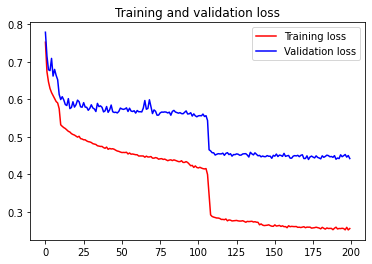

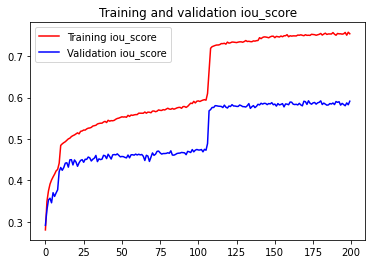

In [10]:
%matplotlib inline
import matplotlib.pyplot as plt
loss = history.history['loss']
val_loss = history.history['val_loss']
iou_score = history.history['iou_score']
val_iou_score = history.history['val_iou_score']

epochs = range(len(loss))

plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.figure()

plt.plot(epochs, iou_score, 'r', label='Training iou_score')
plt.plot(epochs, val_iou_score, 'b', label='Validation iou_score')
plt.title('Training and validation iou_score')
plt.legend()

plt.show()

# loading Created Model

In [13]:
from keras.models import load_model

## change with new saved model name
model = load_model(filepath='docs_models/deeplabv3_fulltraining_epoch_173_valLoss_0.4395.h5', custom_objects={
    "categorical_crossentropy_plus_jaccard_loss":sm.losses.cce_jaccard_loss
    ,"iou_score":sm.metrics.iou_score})

# predicting Validation data

C:\Users\20100\Desktop\ITI\GP\data_semantics\20\utils\util.py:332: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 4, figsize=(16, 16))


KeyboardInterrupt: 

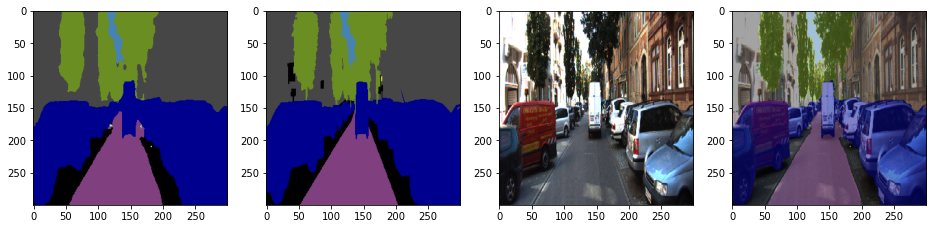

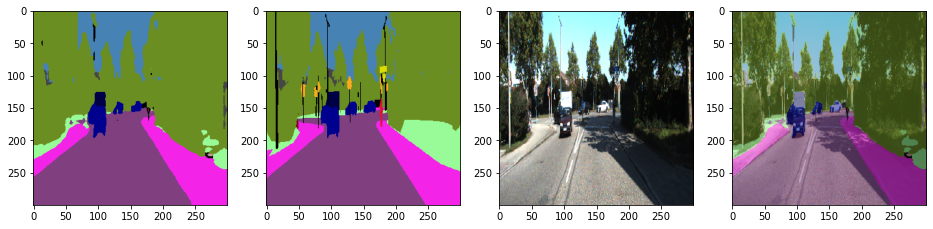

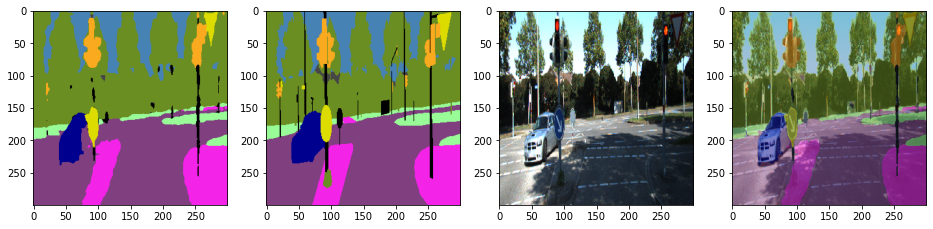

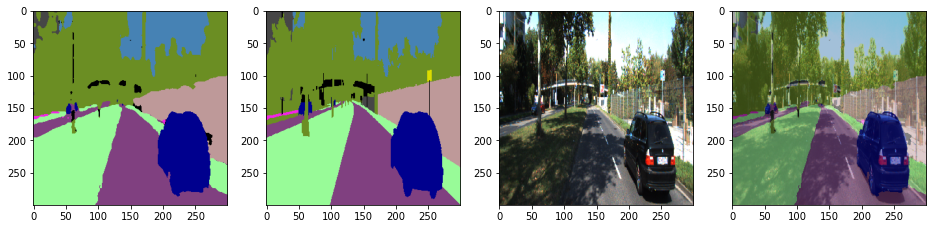

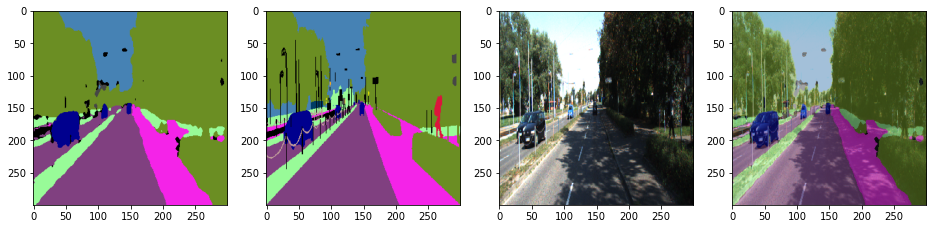

...

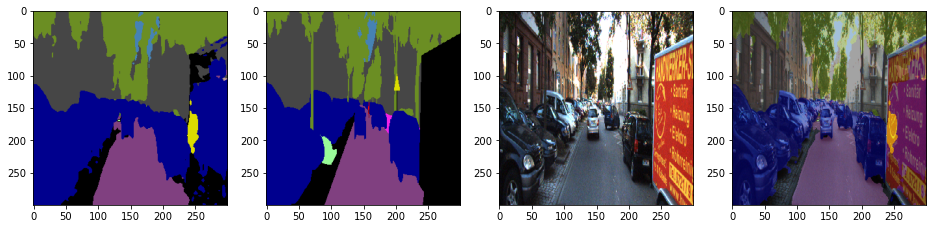

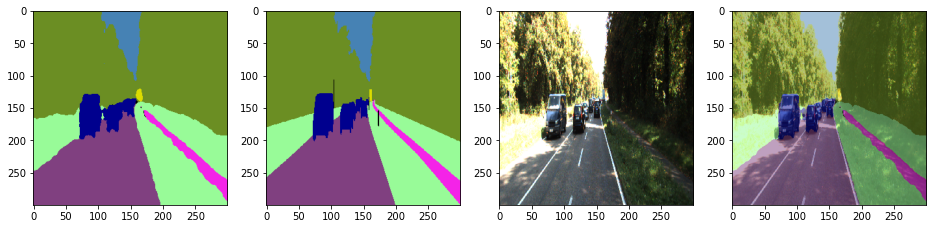

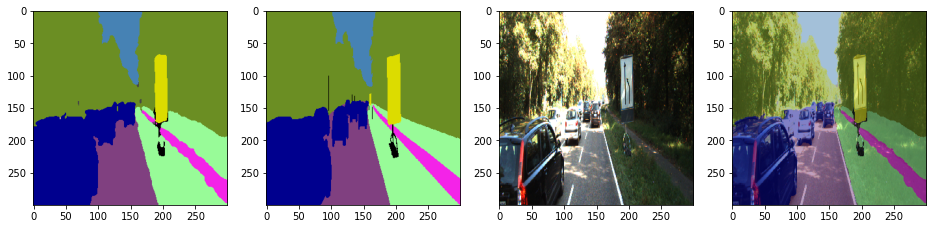

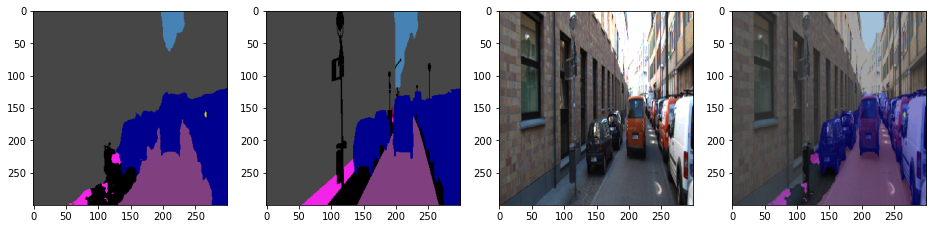

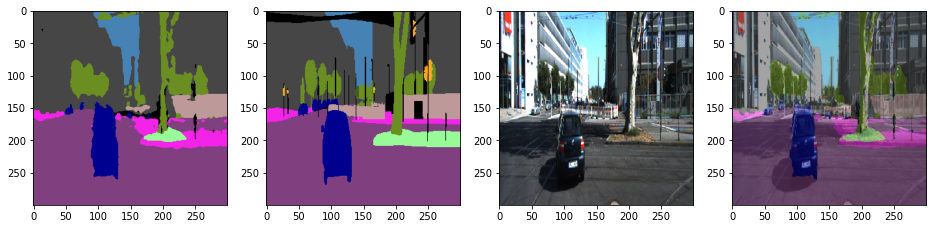

Error in callback <function flush_figures at 0x000002068CA51310> (for post_execute):


KeyboardInterrupt: 

In [14]:
plot_predictions (train_path,model,DIM,mode='valid')

# predicting test data

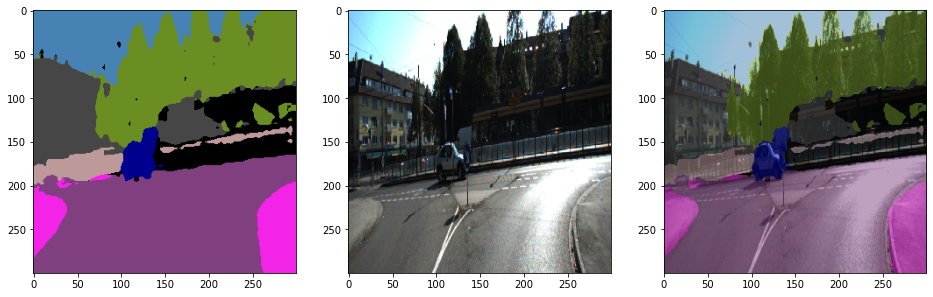

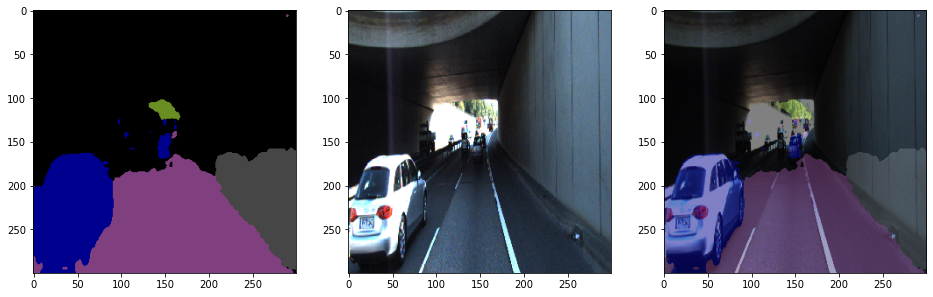

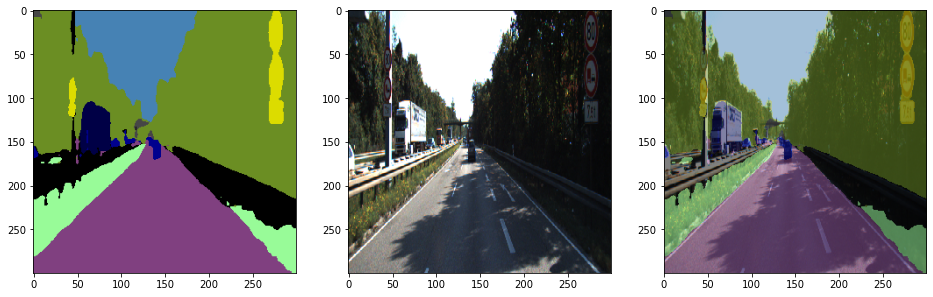

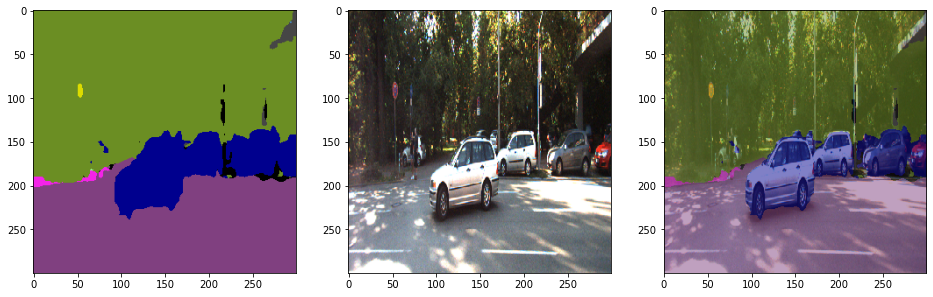

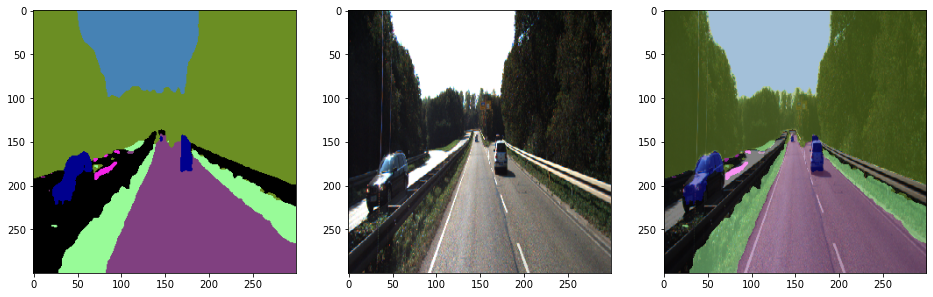

...

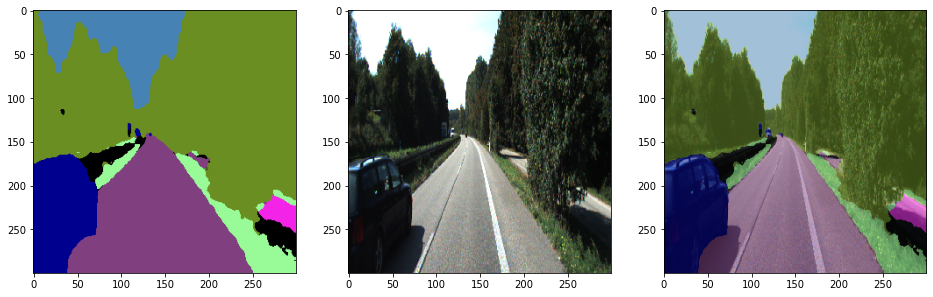

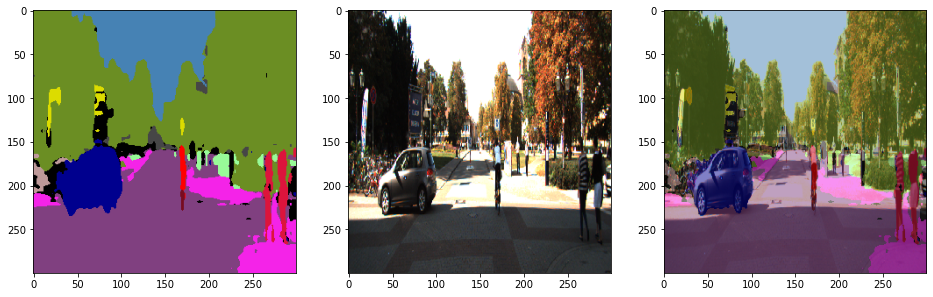

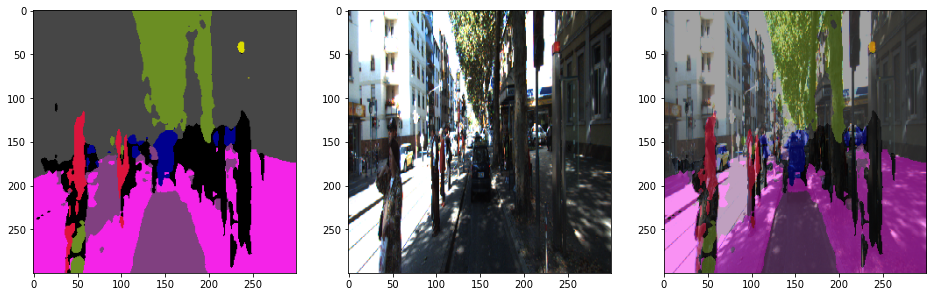

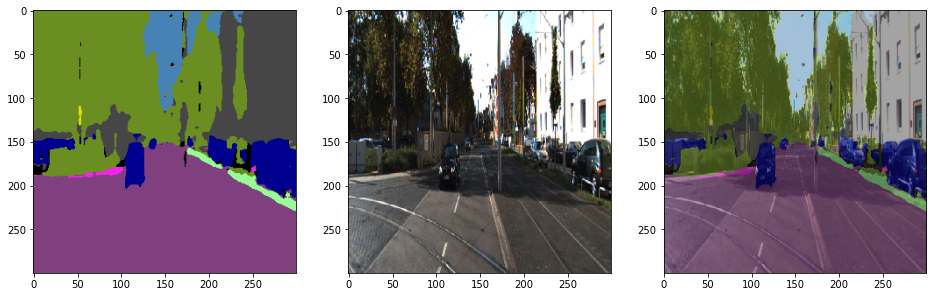

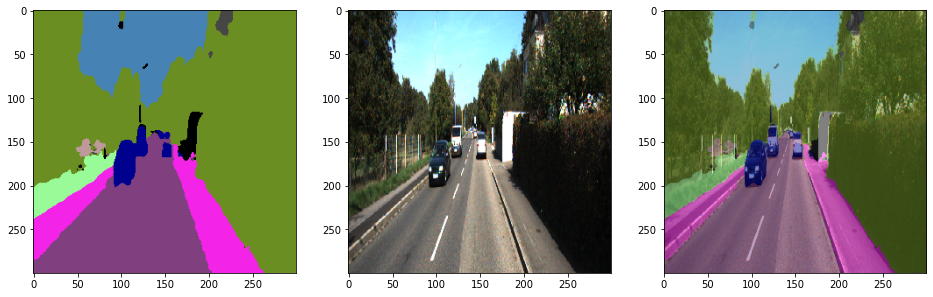

In [15]:
plot_predictions (test_path,model,DIM,mode='testing',test_sample_size=30)

# predicting ITI Data

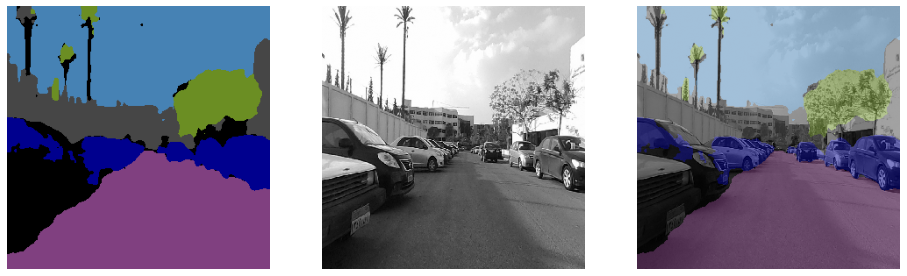

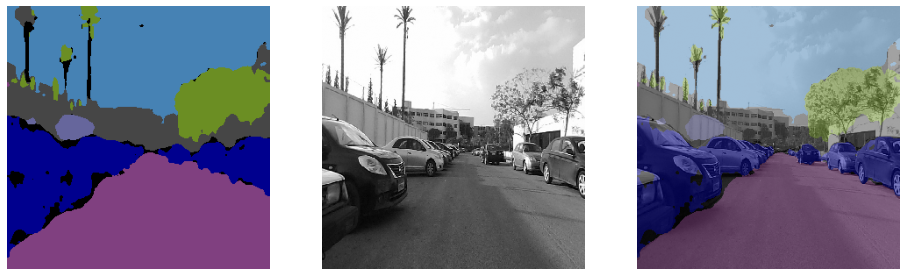

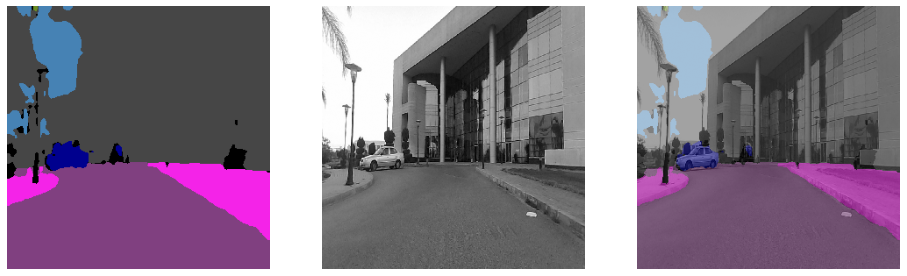

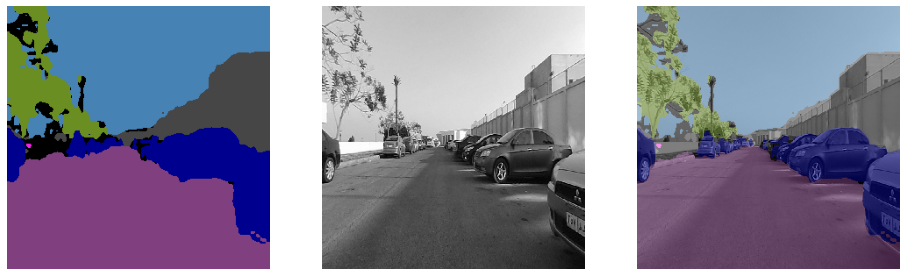

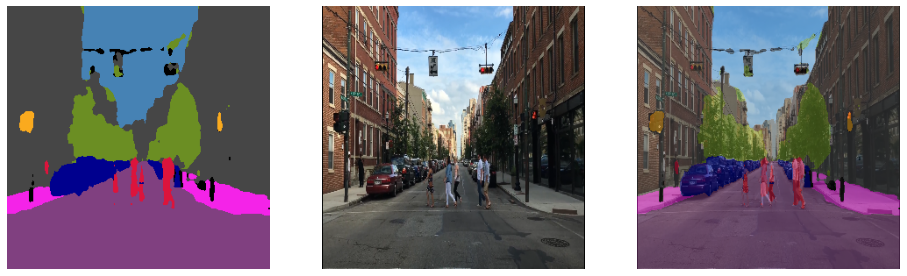

...

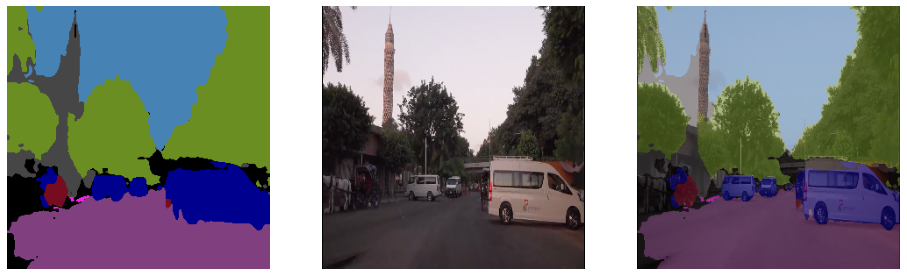

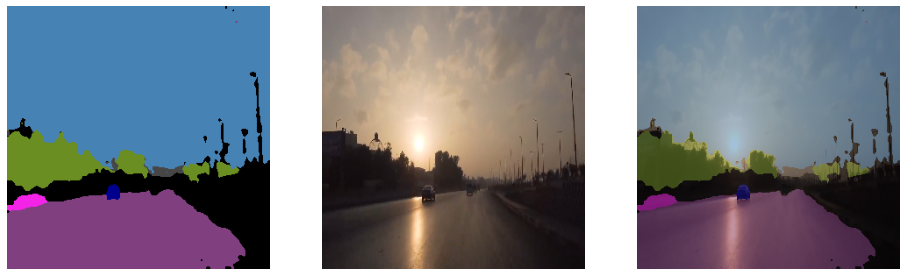

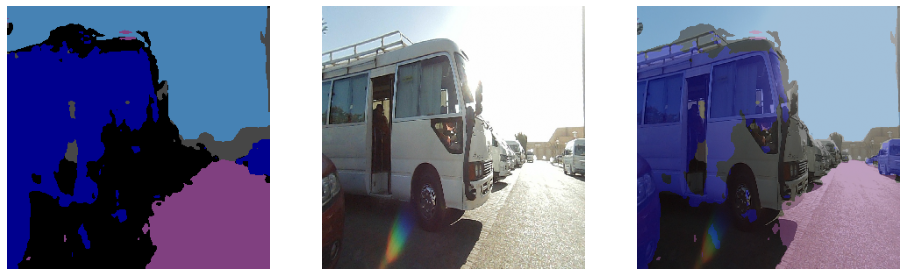

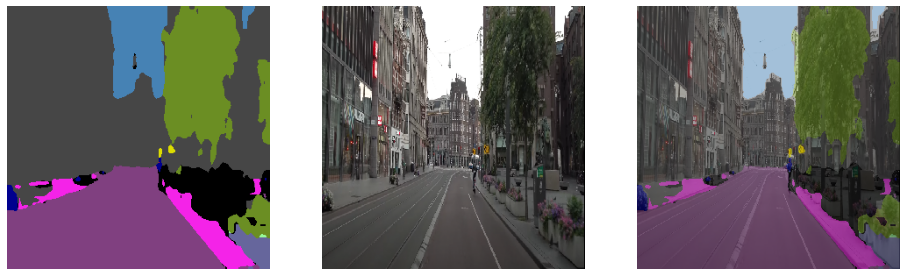

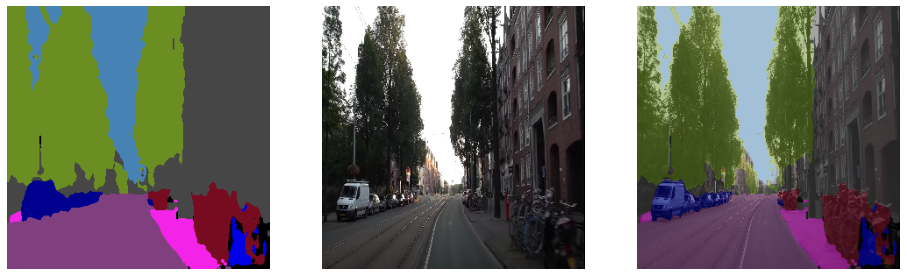

In [17]:
plot_predictions (iti_data_dir,model,DIM,mode='ITI')

In [27]:
train_generator_fn, val_generator_fn, train_length, validation_length = train_valid_generator(train_path, seed, 10, DIM)

Found 2663 images belonging to 1 classes.
Found 2663 images belonging to 1 classes.
Found 538 images belonging to 1 classes.
Found 538 images belonging to 1 classes.


In [28]:
from sklearn.metrics import confusion_matrix

# initialize a confusion matrix
confusion = np.zeros((num_classes, num_classes))
# iterate over the number of steps to generate data
for step in range(55):
    # get the batch of data from the generator
    imgs, y_true = next(val_generator_fn())
    # if y_true is a tuple or list, take the first model output
#     y_true = y_true[0] if isinstance(y_true, (tuple, list)) else y_true
    # get predictions from the network
    y_pred = model.predict(imgs)
    # if pred is a tuple or list, take the first network output
#     y_pred = pred[0] if isinstance(pred, (tuple, list)) else pred
    # extract the label using ArgMax and flatten into a 1D vector
    y_true = np.argmax(y_true, axis=-1).flatten()
    y_pred = np.argmax(y_pred, axis=-1).flatten()
    # calculate the confusion matrix and add to the accumulated matrix
    confusion += confusion_matrix(y_true, y_pred, list(range(num_classes)))
# calculate the metrics from the predicted and ground truth values
# accuracy, mean_per_class_accuracy, mean_iou, iou = metrics(confusion, mask)

In [29]:
epsilon = (confusion.sum(axis=0)) + 1
confusion = (confusion) / epsilon

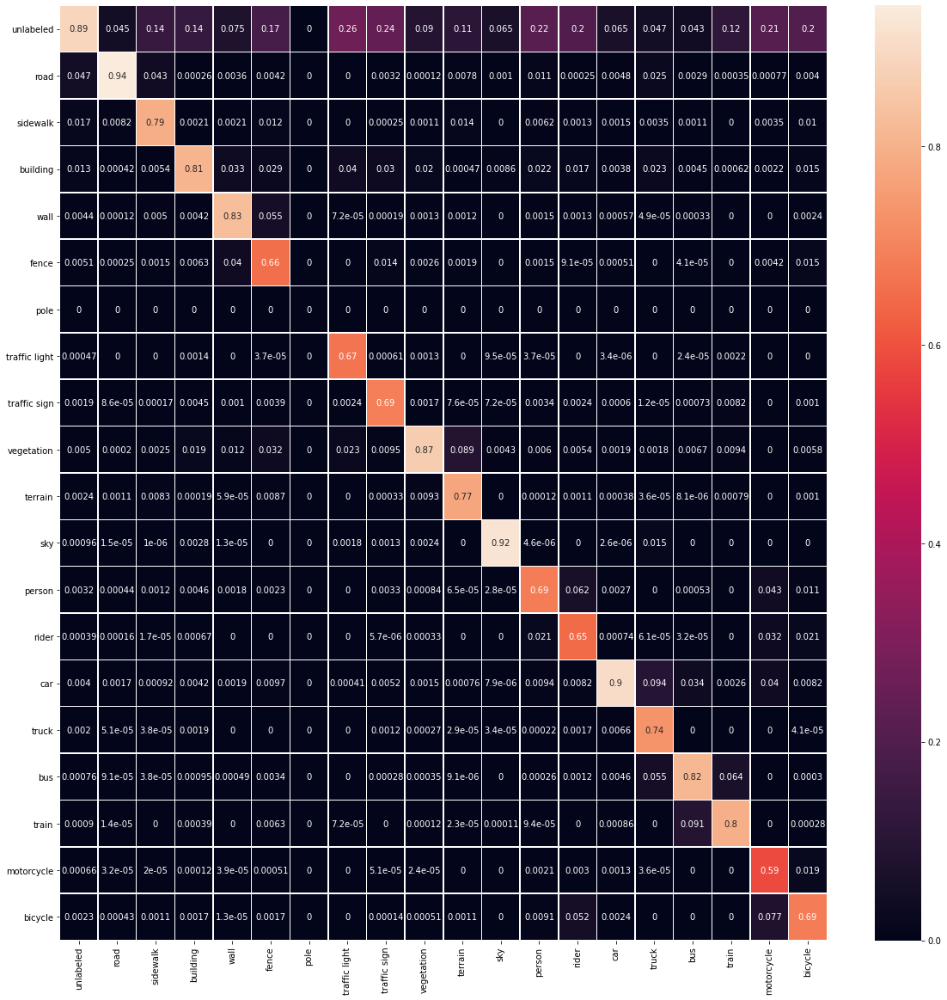

In [30]:
plt.figure(figsize=(20,20))
ax = sns.heatmap(confusion,annot=True, linewidth=0.5, xticklabels=classes.index, yticklabels=classes.index)
plt.show()